In [ ]:
# For QC:
# artificially make rotation and show how to identify it (both manually and automatically)
# download another visium, swap images (+rotation); show how to identify them (both manually and automatically)

In [1]:
#detach("package:visutils", unload=TRUE)
library(visutils)
library(Seurat)

Warning message:
“package ‘Seurat’ was built under R version 4.0.5”
Attaching SeuratObject



Download two public datasets to play with

In [2]:
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.3.0","Visium_Mouse_Olfactory_Bulb",outdir="data")
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.1.0","V1_Adult_Mouse_Brain",outdir="data")
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.1.0","V1_Breast_Cancer_Block_A_Section_1",outdir="data")
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.1.0","V1_Human_Heart",outdir="data")
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.1.0","V1_Human_Lymph_Node",outdir="data")
loadVisiumFrom10x("https://cf.10xgenomics.com/samples/spatial-exp/1.1.0","V1_Mouse_Kidney",outdir="data")

In [ ]:
sids = list.dirs('data',recursive = F,full.names = F)
vs = lapply(sids,function(s)myLoad10X_Spatial(paste0('data/',s),filter.matrix = F,ens_id = T))
names(vs) = sids
length(sids)

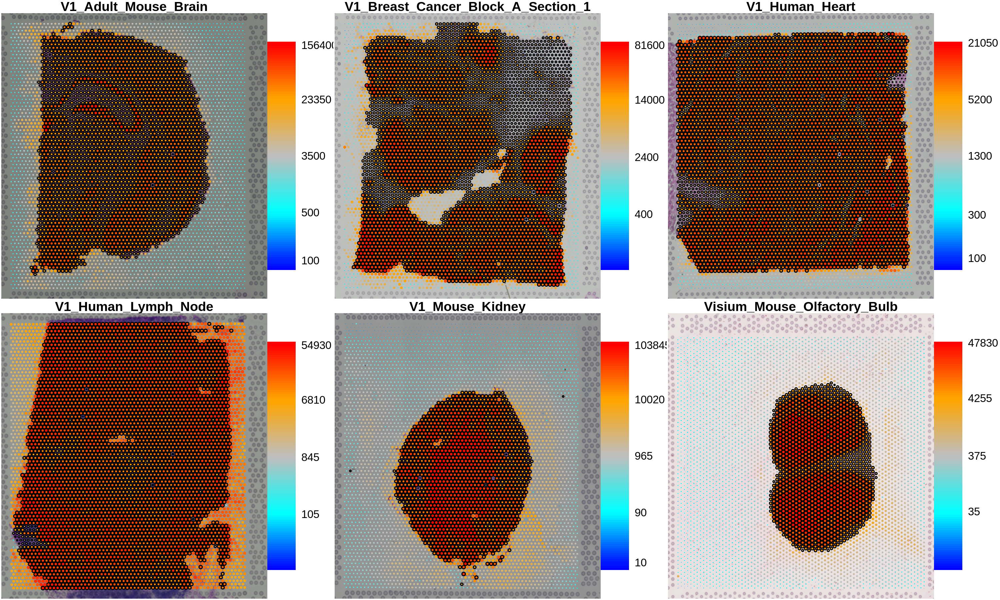

In [8]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 300)
par(mfrow=c(2,3),mar=c(0.1,0.1,1,5),bty='n')
for(n in sids)
    plotVisium(vs[[n]],vs[[n]]$nCount_Spatial,zfun = log1p,cex=scaleTo(log1p(vs[[n]]$nCount_Spatial)),
               main=n,border=ifelse(vs[[n]]$is.tissue==1,'black',NA))

Lets enhance images

In [10]:
for(n in sids)
    vs[[n]]@images$slice1@image = enhanceImage(vs[[n]]@images$slice1@image,pow = 1)

Let's plot RNA-fingerprints (that is total UMI per spot) on the top of H&E images

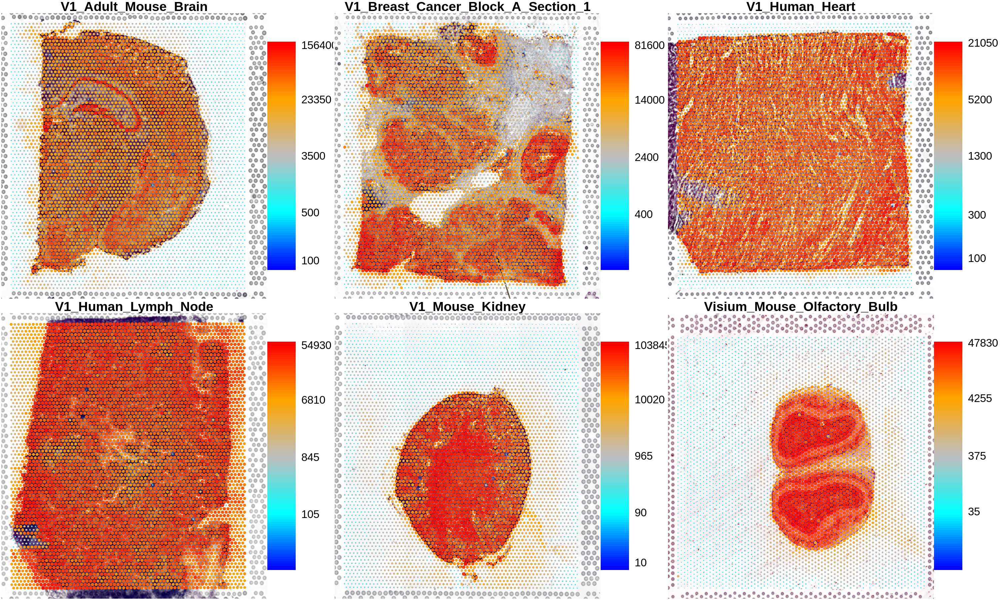

In [13]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 300)
par(mfrow=c(2,3),mar=c(0.1,0.1,1,5),bty='n')
for(n in sids)
    plotVisium(vs[[n]],vs[[n]]$nCount_Spatial,zfun = log1p,cex=scaleTo(log1p(vs[[n]]$nCount_Spatial)),main=n)

Looks ok, but lets H&E images are hirdly distinguishable, lets plot only them. I'll also add small green dots to show autodetected tissue

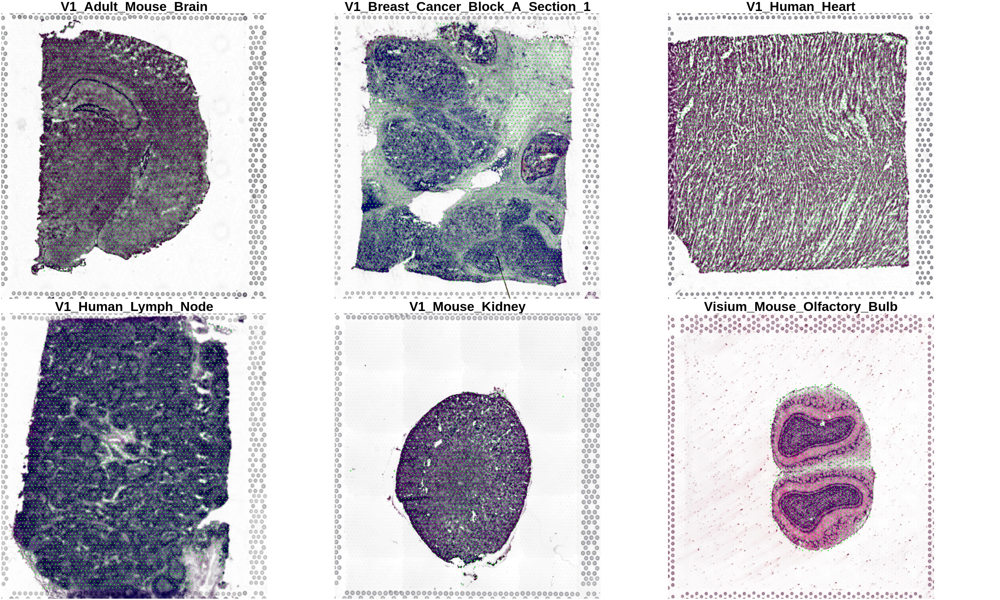

In [21]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 300)
par(mfrow=c(2,3),mar=c(0.1,0.1,1,5),bty='n')
for(n in sids)
    plotVisium(vs[[n]],z='#00FF00',cex=vs[[n]]$is.tissue*.3,main=n)

For visual examination it is clear that RNA-fingerprints (red spots on the top images) are in good agreement with H&E images andf with tissue autodetection (green spots on the bottom image).<br>
In practice however, images can be swapped my mistake or wrongly rotated. The later is rare since introduction of --reorient-images option, but it still could happen either with earlier version of spacerange or if option was omitted or if spaceranger failed to find correct rotation (it is realy rare, but I know one case - out of few hundreds).<br>
Lets model it artificially.

In [ ]:
# make backup
vsbackup=vs
# swap two images
i = vs$V1_Adult_Mouse_Brain@images$slice1@image
vs$V1_Adult_Mouse_Brain@images$slice1@image = vs$Visium_Mouse_Olfactory_Bulb@images$slice1@image
vs$Visium_Mouse_Olfactory_Bulb@images$slice1@image = i


In [ ]:
sessionInfo()